$$r(\eta, \omega) = \begin(bmatrix) \alpha_1 \cos(\eta_1)^\epsilon \cos(\omega)\eta_2 \end(bmatrix)$$

In [1]:
import numpy as np
from matplotlib import pyplot as plt
from src import *

In [2]:
N_sample = 20
omega = np.linspace(0, np.pi / 2, N_sample)[1:-1] # exlude end points because numpy does not like (-1) ** 0.9
eta = np.linspace(0, np.pi / 2, N_sample)[1:-1] # exlude end points because numpy does not like (-1) ** 0.9

from supermariopy import plotting
plotting.set_style()

eta_grid, omega_grid = np.meshgrid(eta, omega)
eta_grid = eta_grid.ravel()
omega_grid = omega_grid.ravel()

colors = make_colors(omega_grid.shape[0])

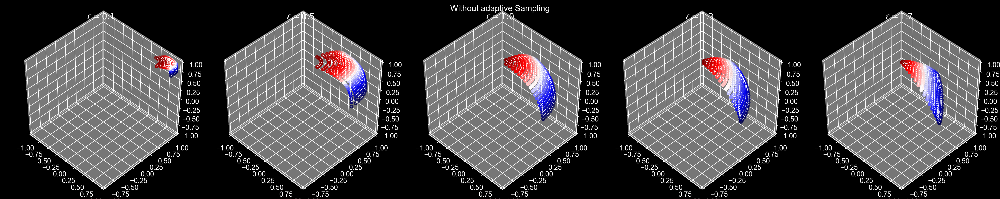

In [3]:
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.cm as cm

with plt.rc_context(plotting.NB_RC_PARAMS_DARK_BG):
    fig = plt.figure(figsize=(20, 4))
    fig.suptitle("Without adaptive Sampling")
    for i, epsilon in enumerate([0.1, 0.5, 1.0, 1.3, 1.7]):
        ax = fig.add_subplot(1, 5, i + 1, projection='3d')
        ax.view_init(45, -45)
        surface_points = surface_function(eta_grid, omega_grid, epsilon, epsilon)
        ax.scatter(surface_points[0, :], surface_points[1, :], surface_points[2, :], c=colors, s=20)
        ax.plot(surface_points[0, :], surface_points[1, :], surface_points[2, :], color="white", linewidth=0.5, linestyle="--")
        ax.set_title(f"$\epsilon = {epsilon}$")
        ax.set_xlim3d([-1.0, 1.0])
        ax.set_ylim3d([-1.0, 1.0])
        ax.set_zlim3d([-1.0, 1.0])

## Adding Adaptive Sampling

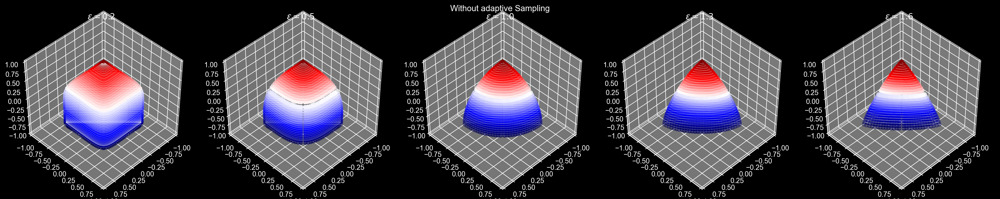

In [4]:
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.cm as cm

a1 = a2 = a3 = 1
N = 100
K = 0.05
with plt.rc_context(plotting.NB_RC_PARAMS_DARK_BG):
    fig = plt.figure(figsize=(20, 4))
    fig.suptitle("Without adaptive Sampling")
    for i, epsilon in enumerate([0.2, 0.5, 1.0, 1.3, 1.6]):
        ax = fig.add_subplot(1, 5, i + 1, projection='3d')
        ax.view_init(45, 45)
        eta_grid, omega_grid = adaptive_sampling_3D_v2(a1, a2, a3, epsilon, epsilon, N=N, K=K)
        colors = make_colors(omega_grid.shape[0])
        surface_points = surface_function(eta_grid, omega_grid, epsilon, epsilon)
        ax.scatter(surface_points[0, :], surface_points[1, :], surface_points[2, :], c=colors, s=30)
        ax.plot(surface_points[0, :], surface_points[1, :], surface_points[2, :], color="white", linewidth=0.25, linestyle="--")
        ax.set_title(f"$\epsilon = {epsilon}$")
        ax.set_xlim3d([-1.0, 1.0])
        ax.set_ylim3d([-1.0, 1.0])
        ax.set_zlim3d([-1.0, 1.0])

# Full Circle comparison

In [5]:
N_sample = 50
omega = np.linspace(-np.pi, np.pi, N_sample)[1:-1] # exlude end points because numpy does not like (-1) ** 0.9
eta = np.linspace(-np.pi / 2, np.pi / 2, N_sample)[1:-1] # exlude end points because numpy does not like (-1) ** 0.9N_sample = 20

from supermariopy import plotting
plotting.set_style()

eta_grid, omega_grid = np.meshgrid(omega, eta)
eta_grid = eta_grid.ravel()
omega_grid = omega_grid.ravel()
colors = make_colors(omega_grid.shape[0])

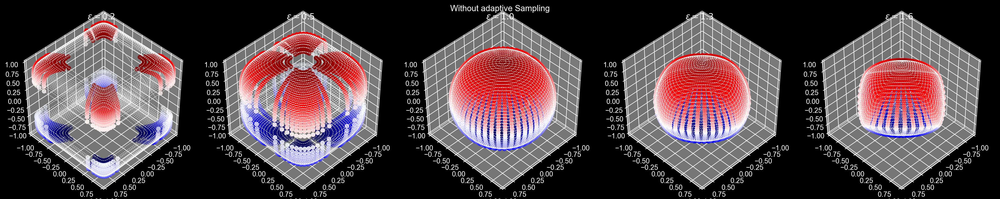

In [6]:
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.cm as cm

with plt.rc_context(plotting.NB_RC_PARAMS_DARK_BG):
    fig = plt.figure(figsize=(20, 4))
    fig.suptitle("Without adaptive Sampling")
    for i, epsilon in enumerate([0.2, 0.5, 1.0, 1.3, 1.6]):
        ax = fig.add_subplot(1, 5, i + 1, projection='3d')
        ax.view_init(45, 45)
        surface_points = surface_function(eta_grid, omega_grid, epsilon, epsilon)
        ax.scatter(surface_points[0, :], surface_points[1, :], surface_points[2, :], c=colors, s=30)
        ax.plot(surface_points[0, :], surface_points[1, :], surface_points[2, :], color="white", linewidth=0.5, linestyle="--")
        ax.set_title(f"$\epsilon = {epsilon}$")
        ax.set_xlim3d([-1.0, 1.0])
        ax.set_ylim3d([-1.0, 1.0])
        ax.set_zlim3d([-1.0, 1.0])

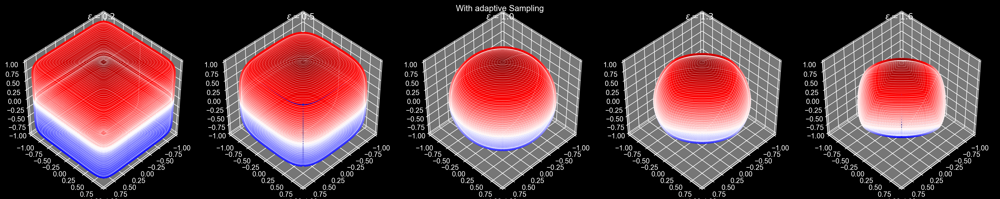

In [7]:
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.cm as cm

a1 = a2 = a3 = 1
N = 50
K = 0.05
with plt.rc_context(plotting.NB_RC_PARAMS_DARK_BG):
    fig = plt.figure(figsize=(20, 4))
    fig.suptitle("With adaptive Sampling")
    for i, epsilon in enumerate([0.2, 0.5, 1.0, 1.3, 1.6]):
        ax = fig.add_subplot(1, 5, i + 1, projection='3d')
        ax.view_init(45, 45)
        eta_grid, omega_grid = adaptive_sampling_3D_full_circle(a1, a2, a3, epsilon, epsilon, N=N, K=K)
        colors = make_colors(omega_grid.shape[0])
        surface_points = surface_function(eta_grid, omega_grid, epsilon, epsilon)
        ax.scatter(surface_points[0, :], surface_points[1, :], surface_points[2, :], c=colors, s=30)
        ax.plot(surface_points[0, :], surface_points[1, :], surface_points[2, :], color="white", linewidth=0.25, linestyle="--")
        ax.set_title(f"$\epsilon = {epsilon}$")
        ax.set_xlim3d([-1.0, 1.0])
        ax.set_ylim3d([-1.0, 1.0])
        ax.set_zlim3d([-1.0, 1.0])

# Sanity Check asymmetric shapes

In [18]:
a1, a2, a3 = [0.5, 0.75, 1.0]
alpha_vec = np.array([a1, a2, a3])
N = 50
K = 0.05

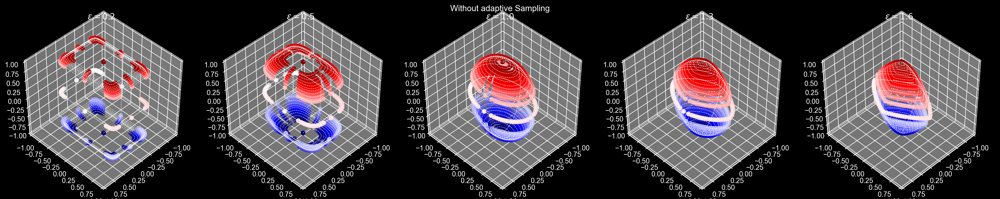

In [19]:
with plt.rc_context(plotting.NB_RC_PARAMS_DARK_BG):
    fig = plt.figure(figsize=(20, 4))
    fig.suptitle("Without adaptive Sampling")
    for i, epsilon in enumerate([0.2, 0.5, 1.0, 1.3, 1.6]):
        ax = fig.add_subplot(1, 5, i + 1, projection='3d')
        ax.view_init(45, 45)
        colors = make_colors(omega_grid.shape[0])
        surface_points = surface_function(eta_grid, omega_grid, epsilon, epsilon, alpha_vec=alpha_vec)
        ax.scatter(surface_points[0, :], surface_points[1, :], surface_points[2, :], c=colors, s=30)
        ax.plot(surface_points[0, :], surface_points[1, :], surface_points[2, :], color="white", linewidth=0.5, linestyle="--")
        ax.set_title(f"$\epsilon = {epsilon}$")
        ax.set_xlim3d([-1.0, 1.0])
        ax.set_ylim3d([-1.0, 1.0])
        ax.set_zlim3d([-1.0, 1.0])

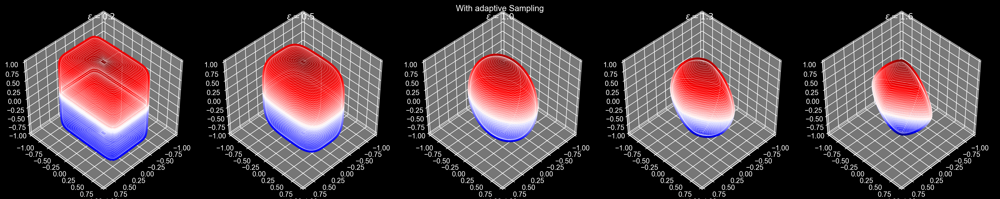

In [20]:
with plt.rc_context(plotting.NB_RC_PARAMS_DARK_BG):
    fig = plt.figure(figsize=(20, 4))
    fig.suptitle("With adaptive Sampling")
    for i, epsilon in enumerate([0.2, 0.5, 1.0, 1.3, 1.6]):
        ax = fig.add_subplot(1, 5, i + 1, projection='3d')
        ax.view_init(45, 45)
        eta_grid, omega_grid = adaptive_sampling_3D_full_circle(a1, a2, a3, epsilon, epsilon, N=N, K=K)
        colors = make_colors(omega_grid.shape[0])
        surface_points = surface_function(eta_grid, omega_grid, epsilon, epsilon, alpha_vec=alpha_vec)
        ax.scatter(surface_points[0, :], surface_points[1, :], surface_points[2, :], c=colors, s=30)
        ax.plot(surface_points[0, :], surface_points[1, :], surface_points[2, :], color="white", linewidth=0.25, linestyle="--")
        ax.set_title(f"$\epsilon = {epsilon}$")
        ax.set_xlim3d([-1.0, 1.0])
        ax.set_ylim3d([-1.0, 1.0])
        ax.set_zlim3d([-1.0, 1.0])